# Plotly 

In [2]:
import pandas as pd
import numpy as np 
import plotly.express as px 
import chart_studio.plotly as py 
import cufflinks as cf
import seaborn as sns
import matplotlib.pyplot as plt
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot 
init_notebook_mode(connected=True)
cf.go_offline()

In [3]:
%config InlineBackend.figure_format = 'svg'

## Basics

Let's make a random dataframe and plot it using **pandas**' built-in plotting functionality, which is powered by **matplotlib**.

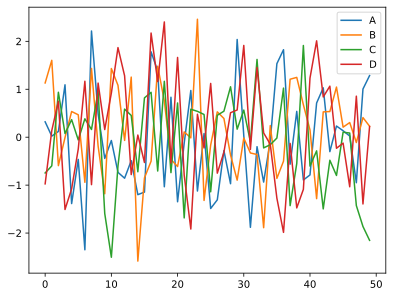

In [4]:
arr_1 = np.random.randn(50, 4)
df_1 = pd.DataFrame(arr_1, columns=['A', 'B', 'C', 'D'])
df_1.plot()
plt.show()

This is OK, but not particularly pretty out of the box. To be fair, **matplotlib** plots can be made a lot prettier with a little bit of work, but there are intrinsic limitations and the library is not designed for interactive plots, but rather for publication-quality static plots.

Let's see how **plotly** fares.

In [5]:
df_1.iplot()

A lot better! The plot is interactive, and the default styling is much nicer. You can zoom in and out, pan around, zoom around a selection and hover over the points to see the exact values.

## Line plots

In [6]:
import plotly.graph_objects as go

Plotly has a lot of real world data sets available, so let's use one of those.

In [7]:
df_stocks = px.data.stocks()

In [8]:
df_stocks

,date,GOOG,AAPL,AMZN,FB,NFLX,MSFT
0,2018-01-01,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,2018-01-08,1.018172,1.011943,1.061881,0.959968,1.053526,1.015988
2,2018-01-15,1.032008,1.019771,1.053240,0.970243,1.049860,1.020524
3,2018-01-22,1.066783,0.980057,1.140676,1.016858,1.307681,1.066561
4,2018-01-29,1.008773,0.917143,1.163374,1.018357,1.273537,1.040708
...,...,...,...,...,...,...,...
100,2019-12-02,1.216280,1.546914,1.425061,1.075997,1.463641,1.720717
101,2019-12-09,1.222821,1.572286,1.432660,1.038855,1.421496,1.752239
102,2019-12-16,1.224418,1.596800,1.453455,1.104094,1.604362,1.784896
103,2019-12-23,1.226504,1.656000,1.521226,1.113728,1.567170,1.802472


In [9]:
px.line(df_stocks, x='date', y='GOOG', labels={'x': 'Date', 'y':'Price'})
px.line(df_stocks, x='date', y=['GOOG', 'AAPL'], 
        labels={'x': 'Date', 'y': 'Price'}, 
        title='Apple vs Google stock prices')

fig = go.Figure()
fig.add_trace(go.Scatter(x=df_stocks.date, y=df_stocks.AAPL, 
              mode = 'lines', name='Apple'))
fig.add_trace(go.Scatter(x=df_stocks.date, y=df_stocks.AMZN, 
              mode = 'lines+markers', name='Amazon'))
fig.add_trace(go.Scatter(x=df_stocks.date, y=df_stocks.GOOG, 
              mode = 'lines+markers', name='Google', 
              line=dict(color='firebrick', width=2, 
                        dash='dashdot')))

fig.update_layout(title='Stock Price Data 2018-2020', 
                  xaxis_title='Price', yaxis_title='Date')

fig.update_layout(xaxis=dict(showline=True, showgrid=False, showticklabels=True, 
                             linecolor='#1e1e1e', linewidth=2, ticks='outside', 
                             tickfont=dict(family='Arial', size=12, color = 'rgb(82, 82, 82)')), 
                 yaxis=dict(showgrid=False, zeroline=False, showline=False, showticklabels=False), 
                 margin=dict(autoexpand=False, l=100, r=20, t=110), 
                 showlegend=True, plot_bgcolor='#1e1e1e')

## Bar charts

In [10]:
df_us = px.data.gapminder().query('country == "United States"')

In [11]:
df_us

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
1608,United States,Americas,1952,68.440,157553000,13990.48208,USA,840
1609,United States,Americas,1957,69.490,171984000,14847.12712,USA,840
1610,United States,Americas,1962,70.210,186538000,16173.14586,USA,840
1611,United States,Americas,1967,70.760,198712000,19530.36557,USA,840
1612,United States,Americas,1972,71.340,209896000,21806.03594,USA,840
1613,United States,Americas,1977,73.380,220239000,24072.63213,USA,840
1614,United States,Americas,1982,74.650,232187835,25009.55914,USA,840
1615,United States,Americas,1987,75.020,242803533,29884.35041,USA,840
1616,United States,Americas,1992,76.090,256894189,32003.93224,USA,840
1617,United States,Americas,1997,76.810,272911760,35767.43303,USA,840


In [12]:
px.bar(df_us, x='year', y='pop', color='lifeExp', labels={'pop':'Population', 'year':'Year'})

In [13]:
df_tips = px.data.tips()
df_tips

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4
...,...,...,...,...,...,...,...
239,29.03,5.92,Male,No,Sat,Dinner,3
240,27.18,2.00,Female,Yes,Sat,Dinner,2
241,22.67,2.00,Male,Yes,Sat,Dinner,2
242,17.82,1.75,Male,No,Sat,Dinner,2


In [14]:
px.bar(df_tips, x='day', y='tip', color='sex', title='Tips by Sex on Each Day', 
       labels={'tip':'Tip Amount', 'day':'Day'})

In [15]:
px.bar(df_tips, x='sex', y='total_bill', color='smoker', title='Total Bill paid by Sex', 
       labels={'sex':'Sex', 'total_bill':'Total Bill'}, barmode='group', height=600)

In [16]:
df_europe = px.data.gapminder().query('continent == "Europe" and year == 2007 and pop > 2e6')

In [17]:
df_europe.head()

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
23,Albania,Europe,2007,76.423,3600523,5937.029526,ALB,8
83,Austria,Europe,2007,79.829,8199783,36126.492700,AUT,40
119,Belgium,Europe,2007,79.441,10392226,33692.605080,BEL,56
155,Bosnia and Herzegovina,Europe,2007,74.852,4552198,7446.298803,BIH,70
191,Bulgaria,Europe,2007,73.005,7322858,10680.792820,BGR,100


In [18]:
fig = px.bar(df_europe, y='pop', x='country', text='pop', color='country', height=700, labels={'pop':'Population', 'country':'Country'})
fig.update_traces(texttemplate='%{text:.3s}', textposition='outside')
fig.update_layout(uniformtext_minsize=8)
fig

## Scatterplots

In [19]:
df_iris = px.data.iris()
df_iris

,sepal_length,sepal_width,petal_length,petal_width,species,species_id
0,5.1,3.5,1.4,0.2,setosa,1
1,4.9,3.0,1.4,0.2,setosa,1
2,4.7,3.2,1.3,0.2,setosa,1
3,4.6,3.1,1.5,0.2,setosa,1
4,5.0,3.6,1.4,0.2,setosa,1
...,...,...,...,...,...,...
145,6.7,3.0,5.2,2.3,virginica,3
146,6.3,2.5,5.0,1.9,virginica,3
147,6.5,3.0,5.2,2.0,virginica,3
148,6.2,3.4,5.4,2.3,virginica,3


In [20]:
px.scatter(df_iris, x='sepal_width', y='sepal_length', color='species', size='petal_length', 
           hover_data=['petal_width'], height=600, width=800)

In [21]:
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=df_iris.sepal_width, y=df_iris.sepal_length, 
    mode='markers', marker_color=df_iris.sepal_width, 
    text=df_iris.species, marker=dict(showscale=True)
))
fig.update_traces(marker_line_width=2, marker_size=10)
fig.update_layout(height=700, width=800)

In [22]:
fig = go.Figure(data=go.Scattergl(
    x = np.random.randn(100000), 
    y = np.random.randn(100000), 
    mode='markers', 
    marker=dict(
        color=np.random.randn(100000), colorscale='Viridis', 
        line_width=1
    )
))
fig.update_layout(height=700)

## Pie Charts

In [23]:
df_asia = px.data.gapminder().query('year == 2007').query('continent == "Asia"')

In [24]:
df_asia

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
11,Afghanistan,Asia,2007,43.828,31889923,974.580338,AFG,4
95,Bahrain,Asia,2007,75.635,708573,29796.048340,BHR,48
107,Bangladesh,Asia,2007,64.062,150448339,1391.253792,BGD,50
227,Cambodia,Asia,2007,59.723,14131858,1713.778686,KHM,116
299,China,Asia,2007,72.961,1318683096,4959.114854,CHN,156
671,"Hong Kong, China",Asia,2007,82.208,6980412,39724.978670,HKG,344
707,India,Asia,2007,64.698,1110396331,2452.210407,IND,356
719,Indonesia,Asia,2007,70.650,223547000,3540.651564,IDN,360
731,Iran,Asia,2007,70.964,69453570,11605.714490,IRN,364
743,Iraq,Asia,2007,59.545,27499638,4471.061906,IRQ,368


In [25]:
threshold = 0.0010 * df_asia['pop'].sum()

df_asia.loc[df_asia['pop'] < threshold, 'country'] = 'Other'

In [26]:
fig = px.pie(df_asia, values='pop', names='country', title='Population of Asian Continent', 
       color_discrete_sequence=px.colors.sequential.RdBu)
fig.update_layout(width=600, height=700)
fig

In [27]:
color_pal = ['blue', 'green', 'black', 'purple', 'red', 'brown']
fig = go.Figure(data=[go.Pie(labels=['Water', 'Grass', 'Normal', 'Psychic', 'Fire', 'Ground'], 
                             values=[110, 90, 80, 70, 50, 77])])
fig.update_traces(hoverinfo='label+percent', textfont_size=20, 
                  textinfo='label+percent', 
                  pull=[0.1, 0, 0.2, 0, 0, 0], 
                  marker=dict(line=dict(color='white', width=2)))
fig.update_layout(height=700, width=600)
fig

I don't like pie charts, but they are a good example of how to use the **plotly** API.

## Histograms

In [28]:
N_rolls = 50000
N_bins = 11
dice_1 = np.random.randint(1, 7, N_rolls)
dice_2 = np.random.randint(1, 7, N_rolls)
dice_sum = dice_1 + dice_2

fig = px.histogram(dice_sum, nbins=N_bins, labels={'value':'Dice Roll'}, 
                   title=f'{N_rolls} Dice Roll Histogram ({N_bins} bins)', 
                   marginal='violin', 
                   color_discrete_sequence=['green'])
fig.update_layout(width=800, height=800, 
                  xaxis_title_text='Dice Roll', yaxis_title_text='Dice Sum', 
                  bargap=0.2, showlegend=False)

fig 

In [29]:
df_tips = px.data.tips()
fig = px.histogram(df_tips, x='total_bill', color='sex', width=900, height=750, nbins=30)
fig

## Box Plots

In [30]:
df_tips = px.data.tips()
px.box(df_tips, x='sex', y='tip', points='all', width=900, height=750, color='sex')

In [31]:
px.box(df_tips, x='day', y='tip', color='sex', height=750, width=900)

In [32]:
fig = go.Figure()
fig.add_trace(go.Box(
    x=df_tips.sex, y=df_tips.tip, 
    marker_color='#1D3922',
    boxmean='sd', 
    fillcolor='#89c694'
))
fig.update_layout(height=700, width=900)

In [33]:
df_stocks = px.data.stocks()

fig = go.Figure()
fig.add_trace(go.Box(y=df_stocks.GOOG, boxpoints='all', 
                     fillcolor='#340074', jitter=0.5, 
                     whiskerwidth=0.2, name='Google'))
fig.add_trace(go.Box(y=df_stocks.AAPL, boxpoints='all', 
                     fillcolor='#B40060', jitter=0.5, 
                     whiskerwidth=0.2, name='Apple'))
fig.update_layout(height=700, width=900, title='Google vs Apple', 
                  yaxis=dict(gridcolor='white', gridwidth=.3), 
                  paper_bgcolor='white', 
                  plot_bgcolor='#D3C1E6')

## Violin Plots

In [34]:
df_tips = px.data.tips()
px.violin(df_tips, y='total_bill', box=True, points='all')

In [35]:
px.violin(df_tips, y='tip', x='smoker', color='sex', box=True, points='all', hover_data=df_tips.columns, height=600)

In [36]:
fig = go.Figure()
fig.add_trace(go.Violin(
    x=df_tips['day'][df_tips['smoker'] == 'Yes'], 
    y=df_tips['total_bill'][df_tips.smoker == 'Yes'], 
    legendgroup='Yes', scalegroup='Yes', name='Yes', 
    side='negative', line_color='blue'
))
fig.add_trace(go.Violin(
    x=df_tips['day'][df_tips['smoker'] == 'No'], 
    y=df_tips['total_bill'][df_tips.smoker == 'No'], 
    legendgroup='Yes', scalegroup='Yes', name='No', 
    side='positive', line_color='red'
))

## Heatmaps

In [37]:
flights = sns.load_dataset('flights')

In [38]:
flights

,year,month,passengers
0,1949,Jan,112
1,1949,Feb,118
2,1949,Mar,132
3,1949,Apr,129
4,1949,May,121
...,...,...,...
139,1960,Aug,606
140,1960,Sep,508
141,1960,Oct,461
142,1960,Nov,390


In [39]:
fig = px.density_heatmap(flights, x='year', y='month', z='passengers', color_continuous_scale=px.colors.plotlyjs.Electric)
fig.update_layout(height=600, width=800)

## 3D Scatterplots

In [40]:
fig = px.scatter_3d(flights, x='year', y='month', z='passengers', 
                    color='year', opacity=0.7)
fig.update_layout(width=800, height=600)

## 3D Line Plots

In [41]:
fig = px.line_3d(flights, x='year', y='month', z='passengers', 
                    color='year')
fig.update_layout(width=800, height=600)

## Scatter Matrix

In [42]:
fig = px.scatter_matrix(flights, color='month')
fig.update_layout(height=700)

## Map Scatter Plots

In [43]:
df = px.data.gapminder().query('year == 2007')

In [44]:
df

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
11,Afghanistan,Asia,2007,43.828,31889923,974.580338,AFG,4
23,Albania,Europe,2007,76.423,3600523,5937.029526,ALB,8
35,Algeria,Africa,2007,72.301,33333216,6223.367465,DZA,12
47,Angola,Africa,2007,42.731,12420476,4797.231267,AGO,24
59,Argentina,Americas,2007,75.320,40301927,12779.379640,ARG,32
...,...,...,...,...,...,...,...,...
1655,Vietnam,Asia,2007,74.249,85262356,2441.576404,VNM,704
1667,West Bank and Gaza,Asia,2007,73.422,4018332,3025.349798,PSE,275
1679,"Yemen, Rep.",Asia,2007,62.698,22211743,2280.769906,YEM,887
1691,Zambia,Africa,2007,42.384,11746035,1271.211593,ZMB,894


In [45]:
fig = px.scatter_geo(df, locations='iso_alpha', color='continent', hover_name='country', size='pop', 
                     projection='orthographic')
fig.update_layout(height=650)

## Choropleth Maps

In [46]:
import json 
from urllib.request import urlopen 
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response: counties=json.load(response)

In [47]:
df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv', dtype={'fips': str})

In [48]:
df

,fips,unemp
0,01001,5.3
1,01003,5.4
2,01005,8.6
3,01007,6.6
4,01009,5.5
...,...,...
3214,72145,13.9
3215,72147,10.6
3216,72149,20.2
3217,72151,16.9


In [50]:
fig = px.choropleth(df, geojson=counties, locations='fips', color='unemp', 
                    color_continuous_scale='Viridis', 
                    range_color=(0, 12), 
                    scope='usa', 
                    labels={'unemp':'Unemployment Rate'})
fig.update_layout(height=600)

## Polar Charts

In [51]:
df_wind = px.data.wind()
fig = px.scatter_polar(df_wind, r='frequency', theta='direction', color='strength', 
                 size='frequency', symbol='strength')
fig.update_layout(height=600)

In [53]:
fig = px.line_polar(df_wind, r='frequency', theta='direction', color='strength', 
                    line_close=True, template='plotly_dark')
fig.update_layout(height=600)
fig.show()

/home/giorgio/anaconda3/lib/python3.9/site-packages/plotly/express/_core.py:271: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/home/giorgio/anaconda3/lib/python3.9/site-packages/plotly/express/_core.py:271: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/home/giorgio/anaconda3/lib/python3.9/site-packages/plotly/express/_core.py:271: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/home/giorgio/anaconda3/lib/python3.9/site-packages/plotly/express/_core.py:271: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/home/giorgio/anaconda3/lib/python3.9/site-packages/plotly/express/_core.py:271: FutureWarning:

The frame.append method is deprecated a

## Ternary Plots

In [54]:
df_exp = px.data.experiment()

In [55]:
df_exp

,experiment_1,experiment_2,experiment_3,gender,group
0,96.876065,93.417942,73.033193,male,control
1,87.301336,129.603395,66.056554,female,control
2,97.691312,106.187916,103.422709,male,treatment
3,102.978152,93.814682,56.995870,female,treatment
4,87.106993,107.019985,72.140292,male,control
...,...,...,...,...,...
95,108.156964,105.971541,64.524029,female,treatment
96,91.739992,111.125377,64.260993,male,control
97,95.410347,84.448322,75.505991,female,control
98,106.362406,115.522382,123.469689,male,treatment


In [64]:
fig = px.scatter_ternary(df_exp, a='experiment_1', b='experiment_2', c='experiment_3', 
                   hover_name='group', color='gender', template='plotly_dark', symbol='group')
fig.update_layout(height=600)

## Facet Plots

In [74]:
df_tips = px.data.tips()
fig = px.scatter(df_tips, x='total_bill', y='tip', color='smoker', facet_col='sex', template='seaborn', symbol='smoker')
fig.update_layout(height=600)

In [75]:
fig = px.histogram(df_tips, x='total_bill', y='tip', color='sex', facet_row='time', facet_col='day', 
             category_orders={'day':['Thur', 'Fri', 'Sat', 'Sun'], 
                              'time':['Lunch', 'Dinner']}, 
             template='seaborn')
fig.update_layout(height=600)

In [76]:
att_df = sns.load_dataset('attention')

In [88]:
att_df = att_df.drop(columns='Unnamed: 0')

In [89]:
att_df.head(4)

,subject,attention,solutions,score
0,1,divided,1,2.0
1,2,divided,1,3.0
2,3,divided,1,3.0
3,4,divided,1,5.0


In [92]:
fig = px.line(att_df, x='solutions', y='score', facet_col='subject', 
              facet_col_wrap=5, title='Scores Based on Attention', color='attention', template='seaborn')
fig.update_layout(height=600)

## Animated Plots

In [98]:
df_cnt = px.data.gapminder()
anim = px.scatter(df_cnt, x='gdpPercap', y='lifeExp', 
           animation_frame='year', 
           animation_group='country', 
           size='pop', color='continent', hover_name='country', 
           log_x=True, size_max=55, range_x=[100, 100**2], 
           range_y=[25, 90], template='seaborn')
anim.update_layout(height=600)

In [101]:
anim = px.bar(df_cnt, x='continent', y='pop', color='continent', 
              animation_frame='year', animation_group='country', 
              range_y=[0, 4000000000], template='plotly_dark')
anim.update_layout(height=650)